In [1]:
import numpy as np
import tensorflow as tf
import pathlib
import matplotlib.pyplot as plt
from tensorflow import keras
import os
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, UpSampling2D, Input, BatchNormalization, Dropout
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import numba
from numba import cuda


# code to make tensors run on GPU
def set_gpu_device():
    physical_devices = tf.config.list_physical_devices('GPU')
    if physical_devices:
        tf.config.set_visible_devices(physical_devices[0], 'GPU')
        tf.config.experimental.set_memory_growth(physical_devices[0], True)
        


def clear_gpu_memory():
    # Select and close the GPU context
    cuda.select_device(0)
    cuda.close()

    # Reinitialize GPU memory (adjust settings as needed)
    gpus = tf.config.experimental.list_physical_devices('GPU')
    if gpus:
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)



# Calling the function to set GPU device
set_gpu_device()
if tf.config.list_physical_devices('GPU'):
    print("GPU is available!")
else:
    print("No GPU found. TensorFlow will use the CPU.")

GPU is available!


In [5]:
# # seting path to the dataset
# train_data = pathlib.Path('new_dataset/train/')
# test_data = pathlib.Path('new_dataset/test/')
# valid_data = pathlib.Path('new_dataset/valid/')


# seting path to the enhanced dataset
train_data = pathlib.Path('_enhanced_new_dataset/train/')
test_data = pathlib.Path('_enhanced_new_dataset/test/')
valid_data = pathlib.Path('_enhanced_new_dataset/valid/')

In [6]:
# defining image generator
train_gen = ImageDataGenerator(
    # rescale=1. / 255,
    rotation_range = 15,
    width_shift_range = 0.1,
    height_shift_range = 0.1,
    shear_range = 10,
    horizontal_flip = True,
    fill_mode = 'nearest',
)

#* Leaving this image generator empty as we are only agumenting train data
test_gen = ImageDataGenerator()
valid_gen = ImageDataGenerator()

#! I dont know why he was changing these parameters with mean
mean = np.array([123.68, 116.779, 103.939], dtype="float32")
train_gen.mean = mean
valid_gen.mean = mean
test_gen.mean = mean

In [7]:
batch_size = 32


#  creating a generator for train.
train = train_gen.flow_from_directory(
    train_data,
    class_mode = "categorical",
    target_size =(244,244),
    color_mode = 'rgb',
    shuffle=False,
    batch_size = batch_size,
)

test = test_gen.flow_from_directory(
    test_data,
    class_mode = "categorical",
    target_size =(244,244),
    color_mode = 'rgb',
    shuffle=False,
    batch_size = batch_size,
)

val = valid_gen.flow_from_directory(
    valid_data,
    class_mode = "categorical",
    target_size =(244,244),
    color_mode = 'rgb',
    shuffle=False,
    batch_size = batch_size,
)

Found 7657 images belonging to 14 classes.
Found 3028 images belonging to 14 classes.
Found 3020 images belonging to 14 classes.


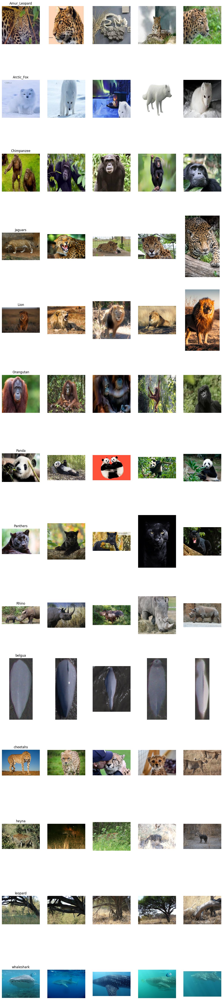

In [5]:
import matplotlib.pyplot as plt

def plot_images_per_class_rows(data_generator, num_images_per_class=5):
    # Get class indices
    class_indices = data_generator.class_indices

    # Plot images in rows
    num_classes = len(class_indices)
    fig, axs = plt.subplots(num_classes, num_images_per_class, figsize=(15, 5 * num_classes))
    # plt.subplots_adjust(wspace=0.5, hspace=0.1)

    for class_name, class_idx in class_indices.items():
        images_in_class = 0
        for i in range(len(data_generator.filenames)):
            if data_generator.classes[i] == class_idx:
                img = plt.imread(data_generator.filepaths[i])
                axs[class_idx, images_in_class].imshow(img)
                axs[class_idx, images_in_class].axis('off')
                axs[class_idx, images_in_class].set_aspect('equal')  # Set equal aspect ratio
                images_in_class += 1
                if images_in_class == num_images_per_class:
                    break

        # Set class name as title for the row
        axs[class_idx, 0].set_title(class_name, fontsize=12)

    # Set class names as column labels
    for ax, class_name in zip(axs[0, :], class_indices.keys()):
        ax.set_xlabel(class_name, rotation=0, labelpad=20, fontsize=12)
    plt.tight_layout
    plt.show()

plot_images_per_class_rows(train, num_images_per_class=5)


In [8]:
import pandas as pd

# Get the class indices
class_indices = train.class_indices

# Get the class labels
class_labels = list(class_indices.keys())

# Get the number of images in each class
class_counts = train.classes
class_counts = pd.Series(class_counts).value_counts().sort_index()

# Display the class distribution
class_distribution = pd.DataFrame({'Class Label': class_labels, 'Count': class_counts})
print(class_distribution)


     Class Label  Count
0   Amur_Leopard    445
1     Arctic_Fox    309
2     Chimpanzee    381
3        Jaguars    488
4           Lion    636
5      Orangutan    422
6          Panda    665
7       Panthers    471
8          Rhino    594
9         belgua    691
10      cheetahs    482
11         heyna    691
12       leopard    691
13    whaleshark    691


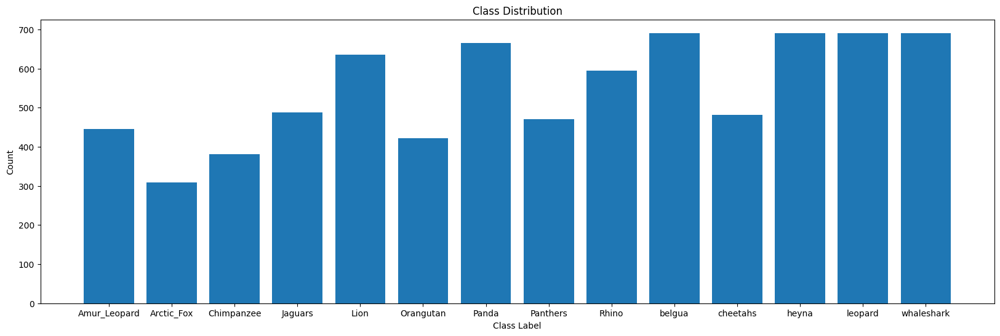

In [9]:
plt.figure(figsize=(20, 6))
plt.bar(class_distribution['Class Label'], class_distribution['Count'])
plt.xlabel('Class Label')
plt.ylabel('Count')
plt.title('Class Distribution')
plt.show()


There seems to be some class imbalance classes like "Arctic_Fox", "Chimpanzee", and "Panthers" have fewer samples compared to classes like "beluga", "heyna" and "whaleshark."

In [10]:
# Calculating class weights
from sklearn.utils.class_weight import compute_class_weight
class_weights = compute_class_weight(class_weight = "balanced", classes= np.unique(train.classes), y= train.classes)
class_weight_dict = dict(enumerate(class_weights))
print("Class weight dict :", class_weight_dict)

Class weight dict : {0: 1.2290529695024077, 1: 1.7699953767914933, 2: 1.4355080614923135, 3: 1.1207552693208431, 4: 0.8599505840071878, 5: 1.296039268788084, 6: 0.8224489795918367, 7: 1.1612071580224446, 8: 0.9207551707551708, 9: 0.7915029977258632, 10: 1.1347065797273266, 11: 0.7915029977258632, 12: 0.7915029977258632, 13: 0.7915029977258632}


In [11]:
from keras.layers import Input, Flatten, Dense, Dropout
from keras.applications import VGG16
from keras.models import Model
from keras.optimizers import SGD

# Load the VGG16 model with pre-trained weights
baseModel = VGG16(weights="imagenet", include_top=False, input_tensor=Input(shape=(224, 224, 3)))

# Freeze the convolutional base
for layer in baseModel.layers:
    layer.trainable = False

# Create the top layers for custom classification
headModel = baseModel.output
headModel = Dense(2048, activation="relu")(headModel)   # adding an extra layer
headModel = BatchNormalization()(headModel)  # adding batch normaization
headModel = Dropout(0.5)(headModel)
headModel = Flatten(name="flatten")(headModel)
headModel = Dense(1024, activation="relu")(headModel)
headModel = BatchNormalization()(headModel)   
headModel = Dropout(0.5)(headModel)
headModel = Dense(1024, activation="relu")(headModel) 
headModel = BatchNormalization()(headModel) 
headModel = Dropout(0.5)(headModel)
headModel = Dense(14, activation="softmax")(headModel)  # Adjusting the number of output classes (14 in this example)

# Create the final model
model = Model(inputs=baseModel.input, outputs=headModel)

# Compile the model
model.compile(loss="categorical_crossentropy", optimizer=SGD(lr=1e-4, momentum=0.9), metrics=["accuracy"])

# Display the model summary
model.summary()

# # Make sure you have frozen the correct layers
for i, layer in enumerate(model.layers):
    print(i, layer.name, layer.trainable)

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

c:\Users\sudha\py10\lib\site-packages\keras\optimizers\optimizer_v2\gradient_descent.py:111: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


In [12]:
import matplotlib.pyplot as plt

# Function to plot learning curves
def plot_learning_curves(history):
    # Plotting training & validation accuracy values
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'])  # Change 'acc' to 'accuracy'
    plt.plot(history.history['val_accuracy'])  # Change 'val_acc' to 'val_accuracy'
    plt.title('Model Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend(['Train', 'Validation'], loc='upper left')

    # Plotting training & validation loss values
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend(['Train', 'Validation'], loc='upper left')

    plt.tight_layout()
    plt.show()


# Function to plot learning curves
def plot_learning_curves2(history):
    # Plotting training & validation accuracy values
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['acc'])  # Change 'acc' to 'accuracy'
    plt.plot(history.history['val_acc'])  # Change 'val_acc' to 'val_accuracy'
    plt.title('Model Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend(['Train', 'Validation'], loc='upper left')

    # Plotting training & validation loss values
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend(['Train', 'Validation'], loc='upper left')

    plt.tight_layout()
    plt.show()
    

In [13]:
def print_accuracy(model, model_name, test_generator, val_generator):
    # Evaluate the model on the test set
    test_loss, test_acc = model.evaluate(test_generator)
    print(f"{model_name} - Test accuracy: {test_acc * 100:.2f}%")

    # Evaluate the model on the validation set
    val_loss, val_acc = model.evaluate(val_generator)
    print(f"{model_name} - Validation accuracy: {val_acc * 100:.2f}%")

#### testing for 10 epoch first

In [12]:
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, LearningRateScheduler
from sklearn.utils.class_weight import compute_class_weight


# a learning rate scheduler 
def lr_scheduler(epoch, lr):
    if epoch % 2 == 0 and epoch > 0: # for every n epoch the lr changese
        lr = lr * 0.9  # we can change this 
    return lr

# Define the callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_loss', save_best_only=True)
lr_schedule = LearningRateScheduler(lr_scheduler)

print("##### Compiling model ######")
opt = SGD(lr=1e-4, momentum=0.9)

model.compile(loss="categorical_crossentropy", optimizer=opt, metrics=["acc"])

# train the head of the network for a few epochs (all other layers
# are frozen) -- this will allow the new FC layers to start to become
# initialized with actual "learned" values versus pure random
print("training head...")
H = model.fit(
    x=train,
    steps_per_epoch=len(train),
    validation_data=val,
    validation_steps=len(val),
    epochs=10,
    callbacks=[early_stopping, model_checkpoint, lr_schedule],  # Adding the callbacks & learning rate scheduler
    class_weight=class_weight_dict
)

##### Compiling model ######
training head...


Epoch 1/10
240/240 [==============================] - 227s 901ms/step - loss: 4.1065 - acc: 0.0742 - val_loss: 2.7215 - val_acc: 0.1265 - lr: 1.0000e-04
Epoch 2/10
240/240 [==============================] - 220s 919ms/step - loss: 3.9823 - acc: 0.0678 - val_loss: 2.5582 - val_acc: 0.1500 - lr: 1.0000e-04
Epoch 3/10
240/240 [==============================] - 224s 929ms/step - loss: 3.9349 - acc: 0.0743 - val_loss: 2.4962 - val_acc: 0.1791 - lr: 9.0000e-05
Epoch 4/10
240/240 [==============================] - 203s 845ms/step - loss: 3.8541 - acc: 0.0730 - val_loss: 2.4649 - val_acc: 0.1970 - lr: 9.0000e-05
Epoch 5/10
240/240 [==============================] - 219s 914ms/step - loss: 3.7964 - acc: 0.0684 - val_loss: 2.4122 - val_acc: 0.2023 - lr: 8.1000e-05
Epoch 6/10
240/240 [==============================] - 200s 835ms/step - loss: 3.7163 - acc: 0.0763 - val_loss: 2.3717 - val_acc: 0.2225 - lr: 8.1000e-05
Epoch 7/10
240/240 [==============================] - 202s 842ms/step - loss: 3.67

In [13]:
model.save("./experimental/vgg_base_experimental.h5")

In [14]:
print_accuracy(model, "Base Model", test, val)

95/95 [==============================] - 39s 413ms/step - loss: 2.3629 - acc: 0.2367
Base Model - Test accuracy: 23.67%
95/95 [==============================] - 33s 352ms/step - loss: 2.3569 - acc: 0.2487
Base Model - Validation accuracy: 24.87%


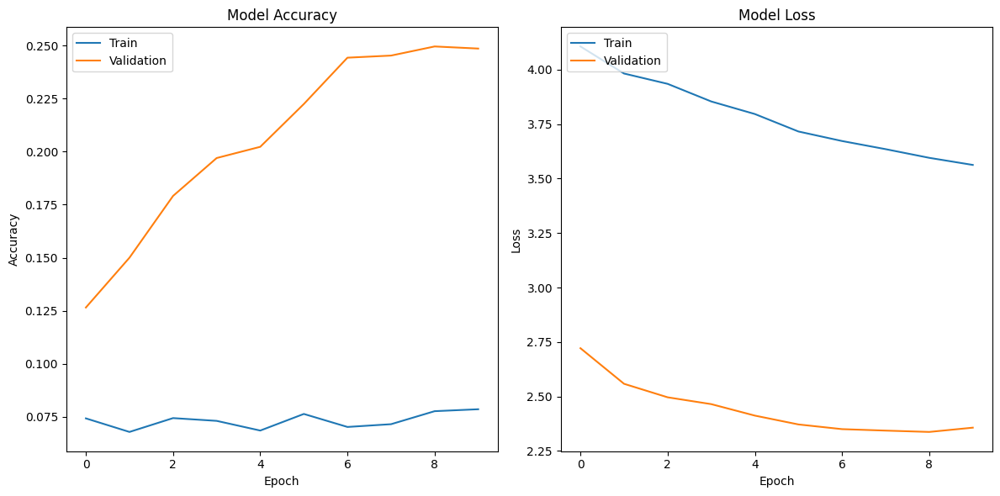

In [15]:
# Assuming you have a baseline_history variable containing the training history
plot_learning_curves2(H)

In [16]:
with tf.device('/CPU:0'):
    model = keras.models.load_model("./experimental/vgg_base_experimental.h5")

In [14]:
import tensorflow as tf
from sklearn.metrics import classification_report, confusion_matrix
from tensorflow import keras
import numpy as np

def evaluate_model(model, data_generator, class_labels):
    # Make predictions on the validation set
    y_pred = model.predict(data_generator)
    y_pred_classes = np.argmax(y_pred, axis=1)

    # Convert one-hot encoded labels to integers
    y_val_classes = data_generator.classes

    # Print the classification report
    print("Classification Report:")
    print(classification_report(y_val_classes, y_pred_classes, target_names=class_labels))

    # Print the confusion matrix
    print("Confusion Matrix:")
    print(confusion_matrix(y_val_classes, y_pred_classes))

In [17]:

evaluate_model(model, val, class_labels)


95/95 [==============================] - 45s 475ms/step
Classification Report:
              precision    recall  f1-score   support

Amur_Leopard       0.07      0.03      0.04       193
  Arctic_Fox       0.27      0.34      0.30       134
  Chimpanzee       0.47      0.42      0.44       166
     Jaguars       0.24      0.67      0.35       212
        Lion       0.18      0.03      0.05       271
   Orangutan       0.28      0.31      0.29       176
       Panda       0.38      0.33      0.35       283
    Panthers       0.27      0.30      0.29       205
       Rhino       0.21      0.36      0.26       249
      belgua       0.68      0.24      0.35       231
    cheetahs       0.19      0.14      0.16       207
       heyna       0.18      0.20      0.19       231
     leopard       0.11      0.13      0.11       231
  whaleshark       0.23      0.09      0.13       231

    accuracy                           0.25      3020
   macro avg       0.27      0.26      0.24      3020
w

In [18]:
Model_Results = model.evaluate(test)
print("LOSS:  " + "%.4f" % Model_Results[0])
print("ACCURACY:  " + "%.4f" % Model_Results[1])

95/95 [==============================] - 43s 452ms/step - loss: 2.3629 - acc: 0.2367
LOSS:  2.3629
ACCURACY:  0.2367


In [13]:
class_names = {v: k for k, v in test.class_indices.items()}
class_names

{0: 'Amur_Leopard',
 1: 'Arctic_Fox',
 2: 'Chimpanzee',
 3: 'Jaguars',
 4: 'Lion',
 5: 'Orangutan',
 6: 'Panda',
 7: 'Panthers',
 8: 'Rhino',
 9: 'belgua',
 10: 'cheetahs',
 11: 'heyna',
 12: 'leopard',
 13: 'whaleshark'}

In [21]:
with tf.device('/CPU:0'):
    model = keras.models.load_model("./experimental/vgg_base_experimental.h5") 

In [11]:
# Mapping of class indices to class names
class_index_to_name = {
    0: 'Amur_Leopard',
    1: 'Arctic_Fox',
    2: 'Chimpanzee',
    3: 'Jaguars',
    4: 'Lion',
    5: 'Orangutan',
    6: 'Panda',
    7: 'Panthers',
    8: 'Rhino',
    9: 'beluga',
    10: 'cheetahs',
    11: 'heyna',
    12: 'leopard',
    13: 'whaleshark',
}


def plot_incorrect_predictions(model, data_generator, class_index_to_name, num_per_class=5):
    # Make predictions on the validation set
    y_pred = model.predict(data_generator)
    y_pred_classes = np.argmax(y_pred, axis=1)

    # Convert one-hot encoded labels to integers
    y_true_classes = data_generator.classes
    incorrect_indices = np.where(y_pred_classes != y_true_classes)[0]

    # Create a dictionary to store incorrect predictions for each class
    incorrect_predictions = {label: [] for label in set(y_true_classes)}

    # Populate the dictionary with incorrect predictions
    for index in incorrect_indices:
        true_label = y_true_classes[index]
        predicted_label = y_pred_classes[index]
        incorrect_predictions[true_label].append((index, predicted_label))

    # Plot the incorrect predictions for each class
    for true_label, predictions in incorrect_predictions.items():
        plt.figure(figsize=(15, 3))
        plt.suptitle(f"Incorrect Predictions for Class {class_index_to_name.get(true_label, true_label)}")
        
        for i, (index, predicted_label) in enumerate(predictions[:num_per_class]):
            batch_index = index // data_generator.batch_size
            batch_remainder = index % data_generator.batch_size
            img, _ = data_generator[batch_index]
            img = img[batch_remainder].astype("uint8")
            
            plt.subplot(1, num_per_class, i + 1)
            plt.imshow(img)
            plt.title(f"True: {class_index_to_name.get(y_true_classes[index], y_true_classes[index])}\nPredicted: {class_index_to_name.get(predicted_label, predicted_label)}")
            plt.axis("off")
        plt.tight_layout()
        plt.show()


95/95 [==============================] - 81s 749ms/step


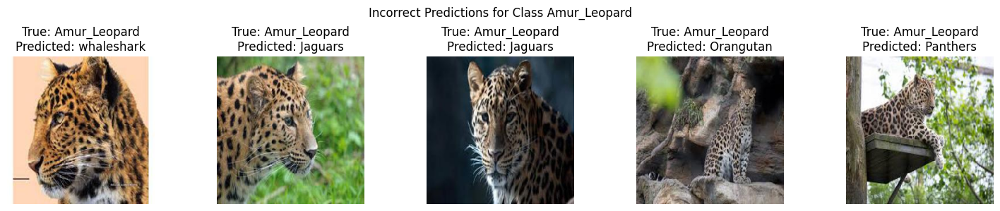

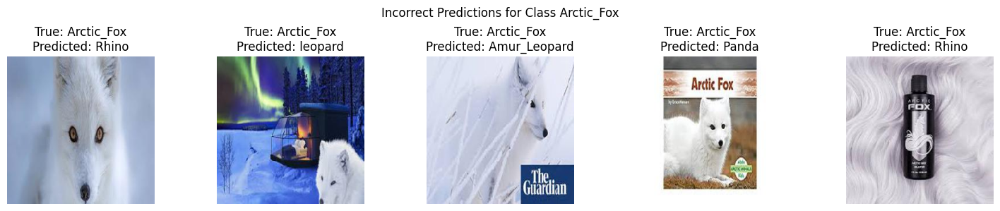

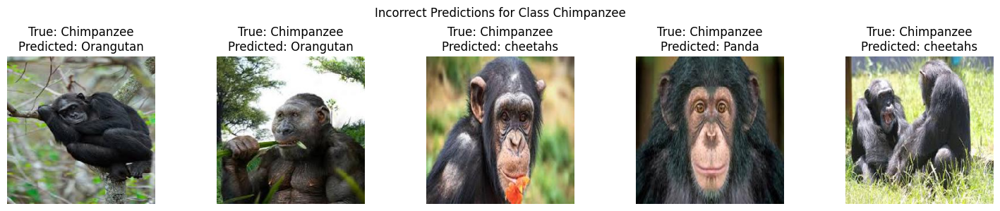

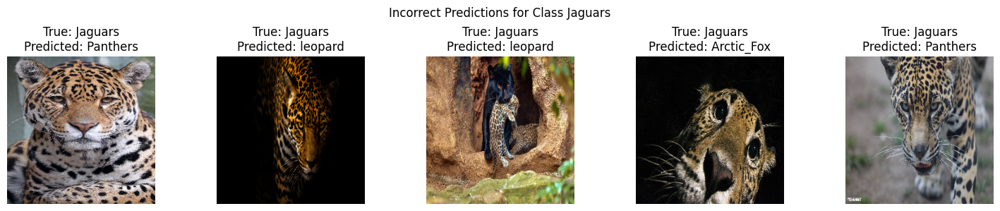

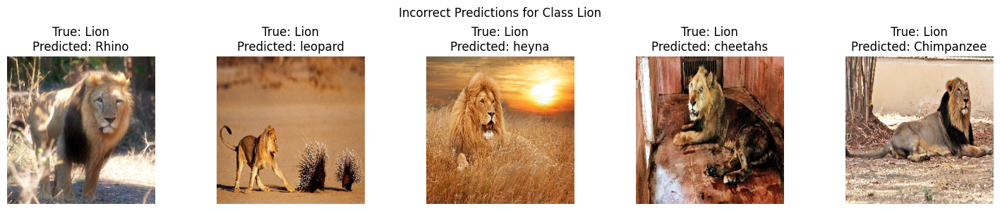

...

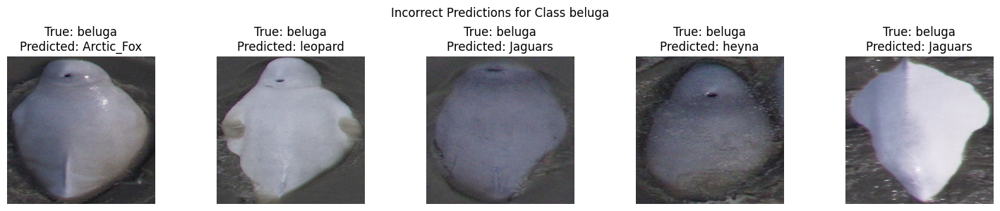

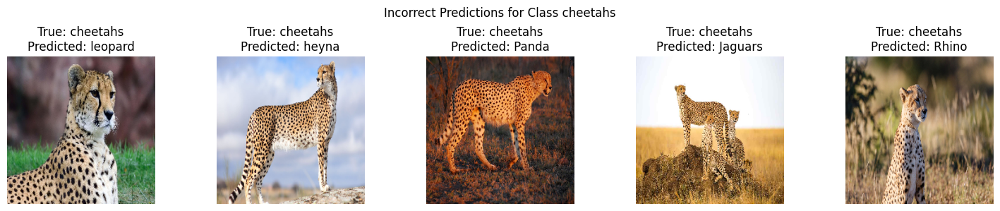

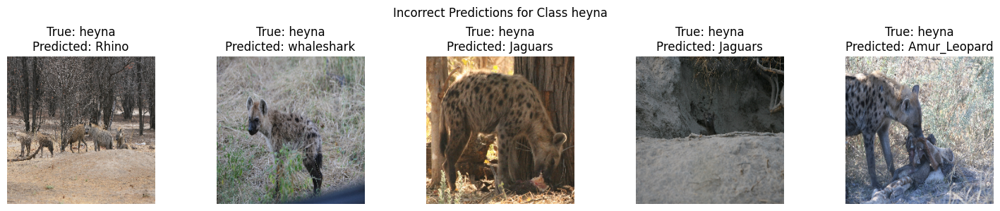

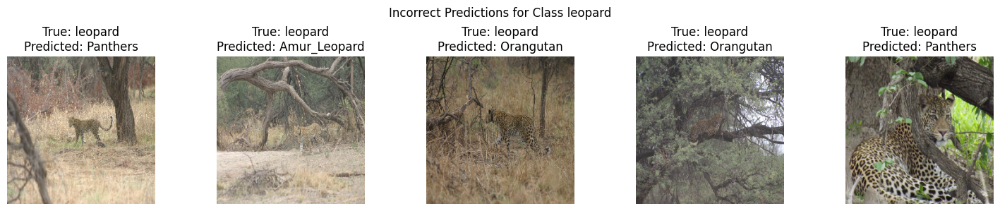

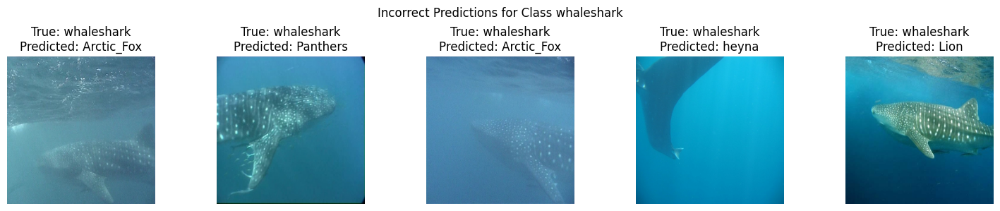

In [22]:

# Example usage:
plot_incorrect_predictions(model, val, class_index_to_name, num_per_class=5)


In [12]:
def plot_correct_predictions(model, data_generator, class_index_to_name, num_per_class=5):
    # Make predictions on the validation set
    y_pred = model.predict(data_generator)
    y_pred_classes = np.argmax(y_pred, axis=1)

    # Convert one-hot encoded labels to integers
    y_true_classes = data_generator.classes
    correct_indices = np.where(y_pred_classes == y_true_classes)[0]

    # Create a dictionary to store incorrect predictions for each class
    correct_predictions = {label: [] for label in set(y_true_classes)}

    # Populate the dictionary with incorrect predictions
    for index in correct_indices:
        true_label = y_true_classes[index]
        predicted_label = y_pred_classes[index]
        correct_predictions[true_label].append((index, predicted_label))

    # Plot the correct predictions for each class
    for true_label, predictions in correct_predictions.items():
        plt.figure(figsize=(15, 3))
        plt.suptitle(f"Correct Predictions for Class {class_index_to_name.get(true_label, true_label)}")
        
        for i, (index, predicted_label) in enumerate(predictions[:num_per_class]):
            batch_index = index // data_generator.batch_size
            batch_remainder = index % data_generator.batch_size
            img, _ = data_generator[batch_index]
            img = img[batch_remainder].astype("uint8")
            
            plt.subplot(1, num_per_class, i + 1)
            plt.imshow(img)
            plt.title(f"True: {class_index_to_name.get(y_true_classes[index], y_true_classes[index])}\nPredicted: {class_index_to_name.get(predicted_label, predicted_label)}")
            plt.axis("off")
        plt.tight_layout()
        plt.show()

95/95 [==============================] - 40s 425ms/step


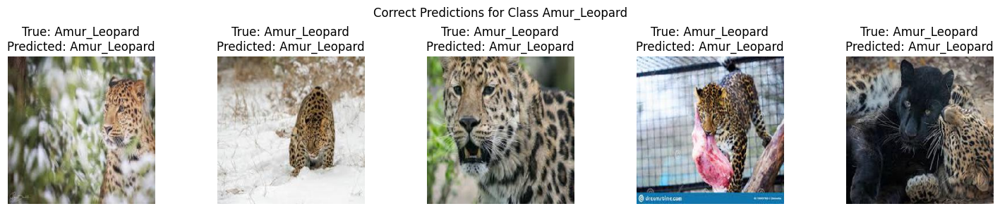

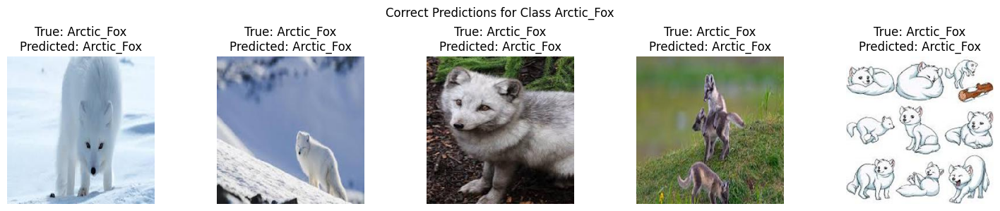

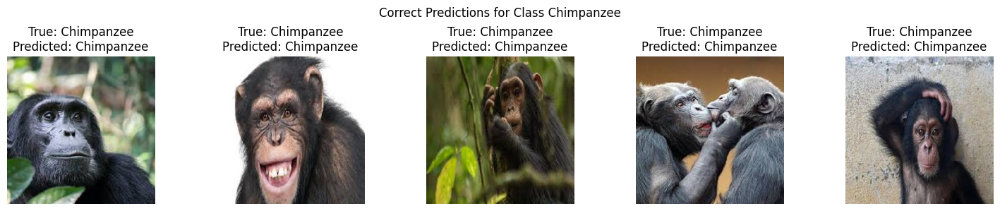

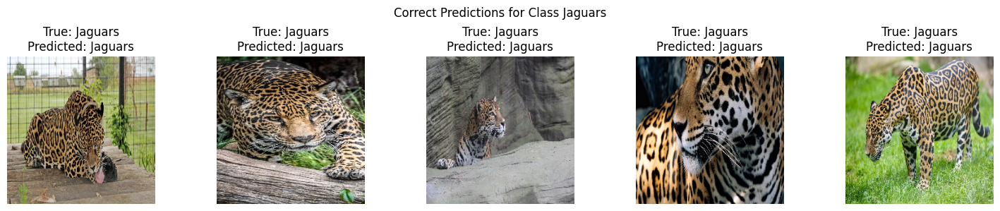

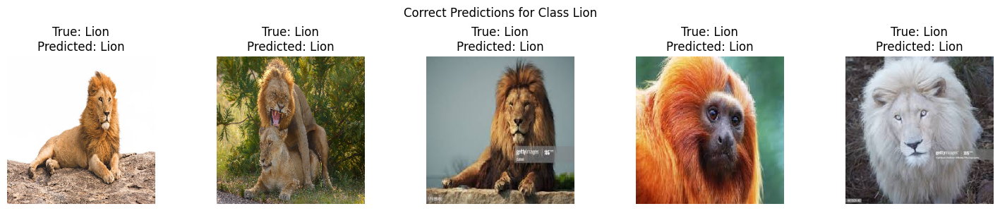

...

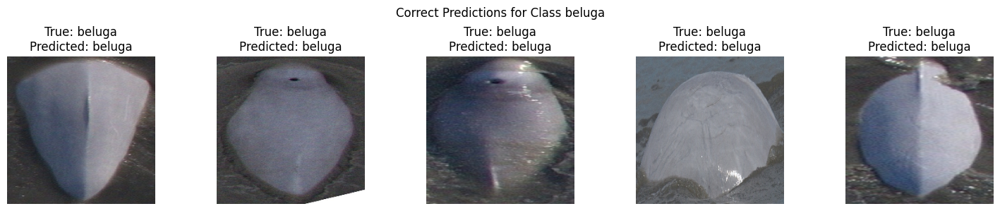

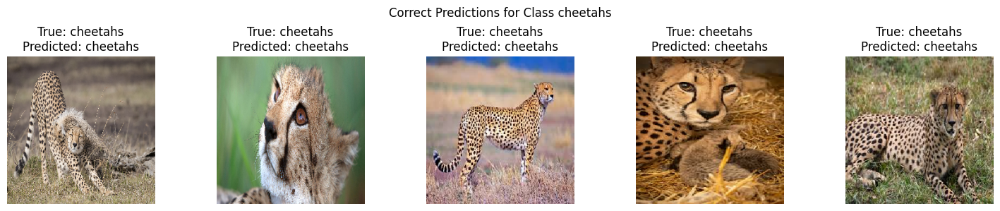

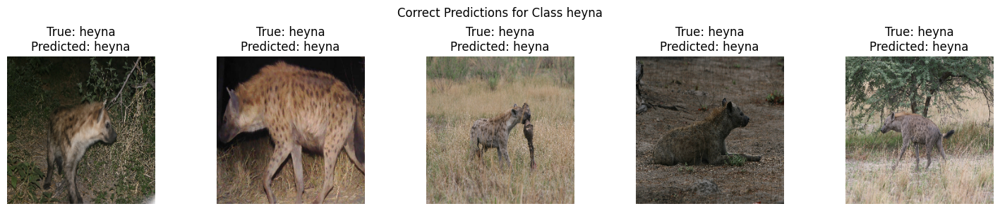

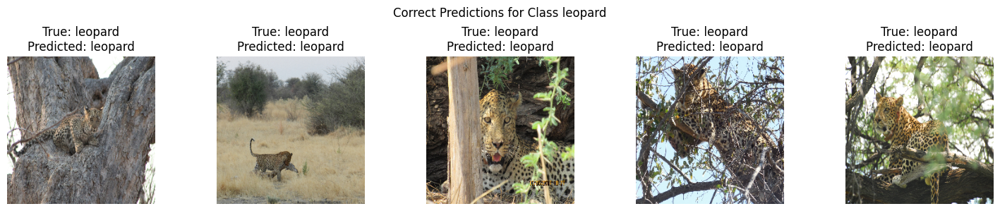

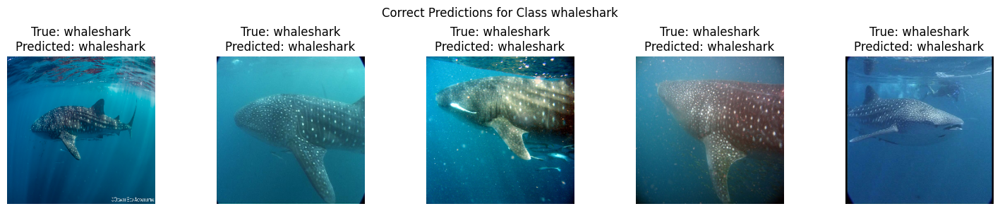

In [37]:



# Example usage:
plot_correct_predictions(model, val, class_index_to_name, num_per_class=5)


In [35]:
# import numpy as np
# import matplotlib.pyplot as plt

# def plot_correct_predictions(model, data_generator, class_index_to_name, num_per_class=5):
#     # Make predictions on the validation set
#     y_pred = model.predict(data_generator)
#     y_pred_classes = np.argmax(y_pred, axis=1)

#     # Convert one-hot encoded labels to integers
#     y_true_classes = data_generator.classes
#     correct_indices = np.where(y_pred_classes == y_true_classes)[0]

#     # Create a dictionary to store correct predictions for each class
#     correct_predictions = {label: [] for label in set(y_true_classes)}

#     # Populate the dictionary with correct predictions
#     for index in correct_indices:
#         true_label = y_true_classes[index]
#         predicted_label = y_pred_classes[index]
#         correct_predictions[true_label].append((index, predicted_label))

#     # Print information for debugging
#     for true_label, predictions in correct_predictions.items():
#         print(f"Class {true_label}: {len(predictions)} correct predictions")

#     print(f"Length of data generator: {len(data_generator)}")

#     # Plot the correct predictions for each class
#     for true_label, predictions in correct_predictions.items():
#         plt.figure(figsize=(15, 3))
#         plt.suptitle(f"Correct Predictions for Class {class_index_to_name.get(true_label, true_label)}")

#         # Counter for the number of correct predictions plotted
#         num_plotted = 0

#         for index, predicted_label in predictions:
#             if num_plotted < num_per_class:
#                 # Use the generator's next method to retrieve the image and label
#                 img, _ = data_generator.next()

#                 img = img[0].astype("uint8")  # Assuming img is a batch; take the first image

#                 plt.subplot(1, num_per_class, num_plotted + 1)
#                 plt.imshow(img)
#                 plt.title(f"True: {class_index_to_name.get(true_label, true_label)}\nPredicted: {class_index_to_name.get(predicted_label, predicted_label)}")
#                 plt.axis("off")

#                 num_plotted += 1

#         plt.tight_layout()  # Add space after the suptitle

#         plt.show()

# # Example usage:
# plot_correct_predictions(model, val, class_index_to_name, num_per_class=5)


### Unfreezing some layers to see the difference (Fine-tuning)

In [13]:
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, LearningRateScheduler
# Unfreeze some layers 
unfreeze_layers = 5  # Number of layers to unfreeze

# Unfreeze layers starting from the specified index
for layer in model.layers[-unfreeze_layers:]:
    layer.trainable = True

# a learning rate scheduler 
def lr_scheduler(epoch, lr):
    if epoch % 2 == 0 and epoch > 0: # for every n epoch the lr changese
        lr = lr * 0.9  # we can change this 
    return lr

# Define the callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
model_checkpoint = ModelCheckpoint('best_model_unfreez.h5', monitor='val_loss', save_best_only=True)
lr_schedule = LearningRateScheduler(lr_scheduler)

# Compile the model again after unfreezing
model.compile(loss="categorical_crossentropy", optimizer=SGD(lr=1e-4, momentum=0.9), metrics=["accuracy"])

# Training the model with some unfreezed layers
print("Fine-tuning...")
H_fine_tune = model.fit(
    x=train,
    steps_per_epoch=len(train),
    validation_data=val,
    validation_steps=len(val),
    epochs=10,
    callbacks=[early_stopping, model_checkpoint, lr_schedule],
    class_weight=class_weight_dict
)

Fine-tuning...
Epoch 1/10
240/240 [==============================] - 686s 3s/step - loss: 4.1211 - accuracy: 0.0731 - val_loss: 2.8378 - val_accuracy: 0.1023 - lr: 1.0000e-04
Epoch 2/10
240/240 [==============================] - 329s 1s/step - loss: 4.0348 - accuracy: 0.0700 - val_loss: 2.6665 - val_accuracy: 0.1454 - lr: 1.0000e-04
Epoch 3/10
240/240 [==============================] - 204s 851ms/step - loss: 3.9351 - accuracy: 0.0743 - val_loss: 2.5688 - val_accuracy: 0.1659 - lr: 9.0000e-05
Epoch 4/10
240/240 [==============================] - 251s 1s/step - loss: 3.8576 - accuracy: 0.0751 - val_loss: 2.5548 - val_accuracy: 0.1682 - lr: 9.0000e-05
Epoch 5/10
240/240 [==============================] - 250s 1s/step - loss: 3.7863 - accuracy: 0.0793 - val_loss: 2.4788 - val_accuracy: 0.2017 - lr: 8.1000e-05
Epoch 6/10
240/240 [==============================] - 223s 928ms/step - loss: 3.7538 - accuracy: 0.0788 - val_loss: 2.4329 - val_accuracy: 0.2119 - lr: 8.1000e-05
Epoch 7/10
240/240 

In [14]:
model.save("./experimental/vgg16_base_unfreezed_experimental.h5")

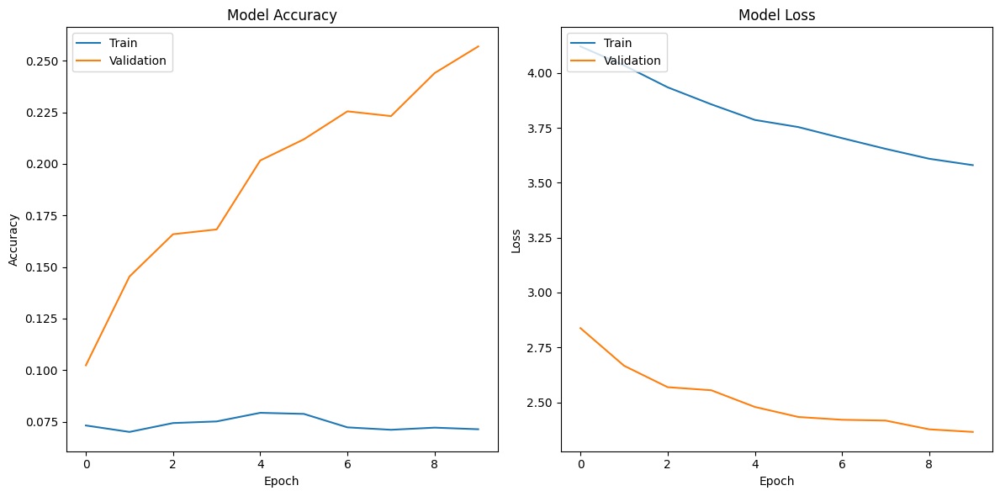

In [16]:
plot_learning_curves(H_fine_tune)

In [20]:
with tf.device('/CPU:0'):
    model_unfreez_baseline = keras.models.load_model("./experimental/vgg16_base_unfreezed_experimental.h5") 
print_accuracy(model_unfreez_baseline, "Baseline UNfreez Model", test, val)
evaluate_model(model_unfreez_baseline, val, class_labels)

95/95 [==============================] - 46s 482ms/step - loss: 2.3533 - accuracy: 0.2569
Baseline UNfreez Model - Test accuracy: 25.69%
95/95 [==============================] - 39s 416ms/step - loss: 2.3648 - accuracy: 0.2570
Baseline UNfreez Model - Validation accuracy: 25.70%
95/95 [==============================] - 40s 423ms/step
Classification Report:
              precision    recall  f1-score   support

Amur_Leopard       0.05      0.06      0.06       193
  Arctic_Fox       0.34      0.51      0.41       134
  Chimpanzee       0.39      0.56      0.46       166
     Jaguars       0.28      0.49      0.36       212
        Lion       0.27      0.07      0.12       271
   Orangutan       0.38      0.10      0.16       176
       Panda       0.43      0.28      0.34       283
    Panthers       0.13      0.58      0.21       205
       Rhino       0.35      0.03      0.05       249
      belgua       0.77      0.77      0.77       231
    cheetahs       0.15      0.21      0.17   

Accuracy increased a bit after unfreezing some layers.

### Trying our Regularization Techniques

In [21]:
clear_gpu_memory()

In [22]:
from keras.layers import Input, Flatten, Dense, Dropout, BatchNormalization
from keras.regularizers import l2
from keras.applications import VGG16
from keras.models import Model
from keras.optimizers import SGD

baseModel = VGG16(weights="imagenet", include_top=False, input_tensor=Input(shape=(224, 224, 3)))

# Freeze the convolutional base
for layer in baseModel.layers:
    layer.trainable = False

# Create the top layers for custom classification
headModel = baseModel.output
headModel = Dense(2048, activation="relu", kernel_regularizer=l2(0.01))(headModel)
headModel = BatchNormalization()(headModel)  # Batch Normalization
headModel = Dropout(0.5)(headModel)
headModel = Flatten(name="flatten")(headModel)
headModel = Dense(1024, activation="relu", kernel_regularizer=l2(0.01))(headModel)  
headModel = BatchNormalization()(headModel)
headModel = Dropout(0.5)(headModel)
headModel = Dense(1024, activation="relu", kernel_regularizer=l2(0.01))(headModel)  
headModel = BatchNormalization()(headModel)
headModel = Dropout(0.5)(headModel)
headModel = Dense(14, activation="softmax")(headModel)

unfreeze_layers = 5

# Unfreeze layers starting from the specified index
for layer in baseModel.layers[-unfreeze_layers:]:
    layer.trainable = True

# Create the final model
model_l2 = Model(inputs=baseModel.input, outputs=headModel)  # Renamed to model2

# Compile the model
model_l2.compile(loss="categorical_crossentropy", optimizer=SGD(lr=1e-4, momentum=0.9), metrics=["accuracy"])

# Display the model summary
model_l2.summary()

# Make sure you have frozen the correct layers
for i, layer in enumerate(model_l2.layers):
    print(i, layer.name, layer.trainable)

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

c:\Users\sudha\py10\lib\site-packages\keras\optimizers\optimizer_v2\gradient_descent.py:111: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


In [23]:
# a learning rate scheduler 
def lr_scheduler(epoch, lr):
    if epoch % 2 == 0 and epoch > 0: # for every n epoch the lr changese
        lr = lr * 0.9  # we can change this 
    return lr

# Define the callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
model_checkpoint = ModelCheckpoint('best_model_l2.h5', monitor='val_loss', save_best_only=True)
lr_schedule = LearningRateScheduler(lr_scheduler)

print("##### Compiling model ######")
opt = SGD(lr=1e-4, momentum=0.9)

model_l2.compile(loss="categorical_crossentropy", optimizer=opt, metrics=["acc"])

# train the head of the network for a few epochs (all other layers
# are frozen) -- this will allow the new FC layers to start to become
# initialized with actual "learned" values versus pure random
print("training head...")
H = model_l2.fit(
    x=train,
    steps_per_epoch=len(train),
    validation_data=val,
    validation_steps=len(val),
    epochs=10,
    callbacks=[early_stopping, model_checkpoint, lr_schedule],  # Adding the callbacks & learning rate scheduler
    class_weight=class_weight_dict
)

##### Compiling model ######
training head...
Epoch 1/10
240/240 [==============================] - 190s 779ms/step - loss: 42.6423 - acc: 0.0721 - val_loss: 41.2236 - val_acc: 0.1089 - lr: 1.0000e-04
Epoch 2/10
240/240 [==============================] - 189s 785ms/step - loss: 42.2154 - acc: 0.0707 - val_loss: 40.7505 - val_acc: 0.1212 - lr: 1.0000e-04
Epoch 3/10
240/240 [==============================] - 191s 795ms/step - loss: 41.7924 - acc: 0.0717 - val_loss: 40.4987 - val_acc: 0.1093 - lr: 9.0000e-05
Epoch 4/10
240/240 [==============================] - 193s 803ms/step - loss: 41.4063 - acc: 0.0707 - val_loss: 40.1395 - val_acc: 0.1185 - lr: 9.0000e-05
Epoch 5/10
240/240 [==============================] - 191s 795ms/step - loss: 41.0728 - acc: 0.0713 - val_loss: 39.8366 - val_acc: 0.1182 - lr: 8.1000e-05
Epoch 6/10
240/240 [==============================] - 192s 797ms/step - loss: 40.7441 - acc: 0.0696 - val_loss: 39.4862 - val_acc: 0.1510 - lr: 8.1000e-05
Epoch 7/10
240/240 [====

In [24]:
model_l2.save("./experimental/vgg16_experimental_l2reg.h5")

In [25]:
clear_gpu_memory()

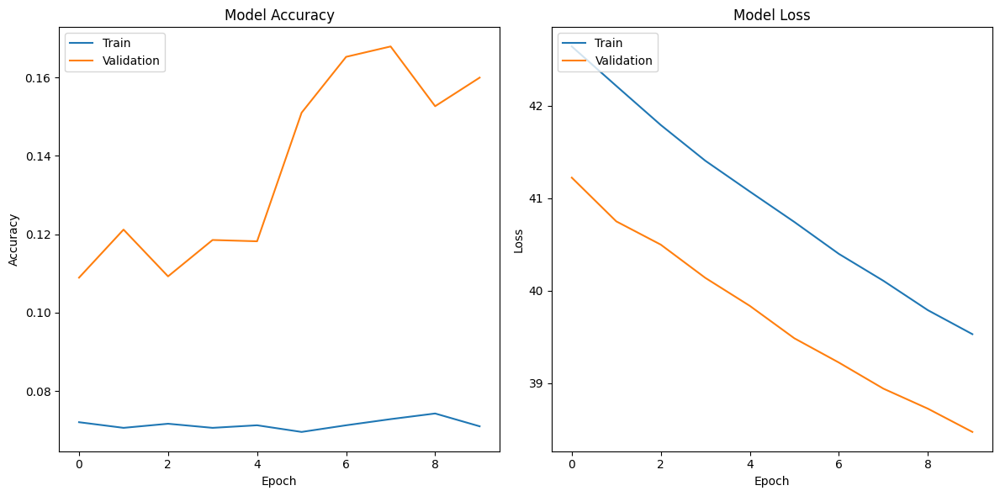

In [26]:
plot_learning_curves2(H)

In [16]:
# clear_gpu_memory()

In [15]:
with tf.device('/CPU:0'):
    model_l2 = keras.models.load_model("./experimental/vgg16_experimental_l2reg.h5") 
print_accuracy(model_l2, "Baseline Model l2reg", test, val)
evaluate_model(model_l2, val, class_labels)

95/95 [==============================] - 48s 495ms/step - loss: 38.4695 - acc: 0.1545
Baseline Model l2reg - Test accuracy: 15.45%
95/95 [==============================] - 50s 525ms/step - loss: 38.4732 - acc: 0.1599
Baseline Model l2reg - Validation accuracy: 15.99%
95/95 [==============================] - 48s 503ms/step
Classification Report:
              precision    recall  f1-score   support

Amur_Leopard       0.09      0.15      0.11       193
  Arctic_Fox       0.25      0.13      0.17       134
  Chimpanzee       0.12      0.18      0.15       166
     Jaguars       0.28      0.39      0.33       212
        Lion       0.20      0.17      0.18       271
   Orangutan       0.16      0.13      0.14       176
       Panda       0.14      0.19      0.16       283
    Panthers       0.07      0.04      0.05       205
       Rhino       0.10      0.03      0.04       249
      belgua       0.35      0.39      0.36       231
    cheetahs       0.10      0.10      0.10       207
    

Test Accuracy:

Base Model: 23.67%
UNFROZEN: 25.69%
L2: 15.45%
Test accuracy is a commonly used metric to evaluate the overall performance of a model on the test dataset. Higher accuracy is generally desirable, indicating a better ability to correctly classify instances. In this case, the UNFROZEN model has the highest accuracy.

Validation Accuracy:

Base Model: 24.87%
UNFROZEN: 25.70%
L2: 15.99%
Validation accuracy provides an estimate of how well the model is likely to perform on unseen data. Similar to test accuracy, the UNFROZEN model has the highest validation accuracy.

F1-Score:

Precision, recall, and F1-score are reported for each class in the classification report.
F1-score is the harmonic mean of precision and recall. It is useful when there is an uneven class distribution.
Confusion Matrix:

A matrix that shows the number of true positives, true negatives, false positives, and false negatives for each class.
Considering these metrics:

If overall accuracy is the primary concern, the UNFROZEN model seems to perform the best.
If class imbalances are a concern, and false positives/negatives have different costs, consider looking at F1-scores or the confusion matrix for each class.

### Further fintuing by finding best optimizer for the best model so far  

In [18]:
import numpy as np
import tensorflow as tf
import pathlib
import matplotlib.pyplot as plt
from tensorflow import keras
import os
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, UpSampling2D, Input, BatchNormalization, Dropout, Dense, Flatten
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils.class_weight import compute_class_weight
from keras.applications import VGG16
from keras.optimizers import SGD, Adam, RMSprop, Adagrad
from keras.callbacks import EarlyStopping, ModelCheckpoint, LearningRateScheduler
from sklearn.metrics import classification_report, confusion_matrix
from keras.regularizers import l2


In [14]:
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, LearningRateScheduler
from tensorflow.keras.optimizers import SGD, Adam, RMSprop, Adagrad

def create_and_train_model(optimizer, learning_rate=1e-4, name="model"):
    baseModel = VGG16(weights="imagenet", include_top=False, input_tensor=Input(shape=(224, 224, 3)))

    # Freeze the convolutional base
    for layer in baseModel.layers:
        layer.trainable = False
        
    #!using the base model by unfreezing some layers
    # Create the top layers for custom classification
    headModel = baseModel.output
    headModel = Dense(2048, activation="relu")(headModel)   # adding an extra layer
    headModel = BatchNormalization()(headModel)  # adding batch normaization
    headModel = Dropout(0.5)(headModel)
    headModel = Flatten(name="flatten")(headModel)
    headModel = Dense(1024, activation="relu")(headModel)
    headModel = BatchNormalization()(headModel)   
    headModel = Dropout(0.5)(headModel)
    headModel = Dense(1024, activation="relu")(headModel) 
    headModel = BatchNormalization()(headModel) 
    headModel = Dropout(0.5)(headModel)
    headModel = Dense(14, activation="softmax")(headModel)  # Adjusting the number of output classes (14 in this example)

    # # Create the top layers for custom classification
    # headModel = baseModel.output
    # headModel = Dense(2048, activation="relu", kernel_regularizer=l2(0.01))(headModel)
    # headModel = BatchNormalization()(headModel)
    # headModel = Dropout(0.5)(headModel)
    # headModel = Flatten(name="flatten")(headModel)
    # headModel = Dense(1024, activation="relu", kernel_regularizer=l2(0.01))(headModel)
    # headModel = BatchNormalization()(headModel)
    # headModel = Dropout(0.5)(headModel)
    # headModel = Dense(1024, activation="relu", kernel_regularizer=l2(0.01))(headModel)
    # headModel = BatchNormalization()(headModel)
    # headModel = Dropout(0.5)(headModel)
    # headModel = Dense(14, activation="softmax")(headModel)

    unfreeze_layers = 5

    # Unfreeze layers starting from the specified index
    for layer in baseModel.layers[-unfreeze_layers:]:
        layer.trainable = True

    # Create the final model
    model = Model(inputs=baseModel.input, outputs=headModel)
    
    # Compile the model with the specified optimizer and learning rate
    if optimizer == 'sgd':
        opt = SGD(lr=learning_rate)
    elif optimizer == 'adam':
        opt = Adam(lr=learning_rate)
    elif optimizer == 'rmsprop':
        opt = RMSprop(lr=learning_rate)
    elif optimizer == 'adagrad':
        opt = Adagrad(lr=learning_rate)
    else:
        raise ValueError("Invalid optimizer specified.")

    model.compile(loss="categorical_crossentropy", optimizer=opt, metrics=["accuracy"])

    # Display the model summary
    model.summary()

    # Learning rate scheduler function
    def lr_scheduler(epoch, lr):
        if epoch % 2 == 0 and epoch > 0:
            lr = lr * 0.9
        return lr

    # Train the model
    history = model.fit(
        x=train,
        steps_per_epoch=len(train),
        validation_data=val,
        validation_steps=len(val),
        epochs=10,  # You can adjust the number of epochs
        callbacks=[
            EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
            ModelCheckpoint(f'best_model_{name}.h5', monitor='val_loss', save_best_only=True),
            LearningRateScheduler(lr_scheduler)
        ],
        class_weight=class_weight_dict
    )
    
    # Save the entire model
    model.save(f'./experimental/{name}_model.h5')

    return model, history

# Example usage:
# model, history = create_and_train_model(optimizer='adam', learning_rate=1e-4, name='adam_model')
# plot_learning_curves2(history)  # Assuming you have the plot_learning_curves2 function defined
# print_accuracy(model, "Adam Model", test, val)


In [15]:
model_adam, history_adam = create_and_train_model(optimizer='adam', learning_rate=1e-4, name='adam_model')

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

c:\Users\sudha\py10\lib\site-packages\keras\optimizers\optimizer_v2\adam.py:114: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


Epoch 1/10
240/240 [==============================] - 231s 919ms/step - loss: 3.9881 - accuracy: 0.0687 - val_loss: 3.9601 - val_accuracy: 0.0934 - lr: 1.0000e-04
Epoch 2/10
240/240 [==============================] - 184s 767ms/step - loss: 3.6903 - accuracy: 0.0657 - val_loss: 3.1892 - val_accuracy: 0.0510 - lr: 1.0000e-04
Epoch 3/10
240/240 [==============================] - 184s 768ms/step - loss: 3.5132 - accuracy: 0.0757 - val_loss: 2.7497 - val_accuracy: 0.0805 - lr: 9.0000e-05
Epoch 4/10
240/240 [==============================] - 182s 760ms/step - loss: 3.4758 - accuracy: 0.0722 - val_loss: 2.6480 - val_accuracy: 0.0868 - lr: 9.0000e-05
Epoch 5/10
240/240 [==============================] - 188s 780ms/step - loss: 3.4109 - accuracy: 0.0666 - val_loss: 2.6298 - val_accuracy: 0.0828 - lr: 8.1000e-05
Epoch 6/10
240/240 [==============================] - 164s 682ms/step - loss: 3.3319 - accuracy: 0.0733 - val_loss: 2.6647 - val_accuracy: 0.0841 - lr: 8.1000e-05
Epoch 7/10
240/240 [==

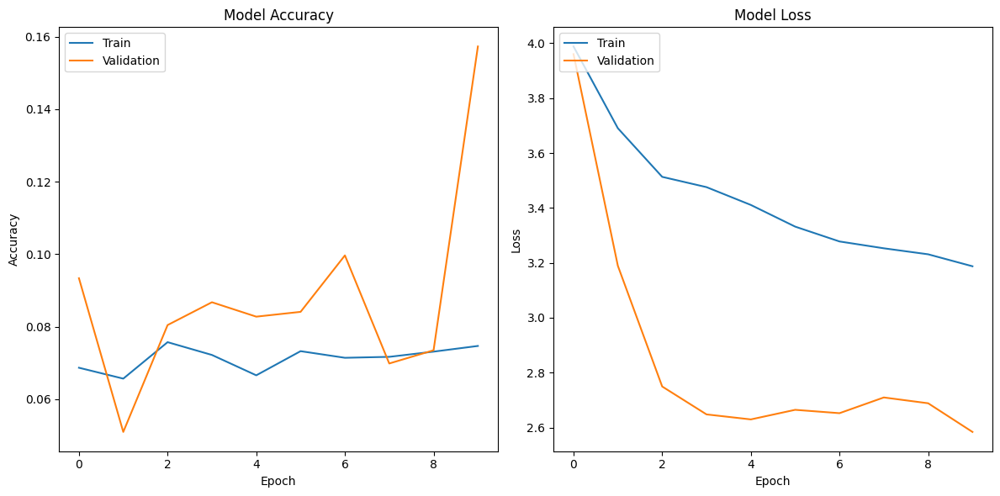

95/95 [==============================] - 39s 416ms/step - loss: 2.5859 - accuracy: 0.1638
Adam Model - Test accuracy: 16.38%
95/95 [==============================] - 33s 344ms/step - loss: 2.5842 - accuracy: 0.1573
Adam Model - Validation accuracy: 15.73%
95/95 [==============================] - 32s 335ms/step
Classification Report:
              precision    recall  f1-score   support

Amur_Leopard       0.13      0.02      0.03       193
  Arctic_Fox       0.05      0.07      0.06       134
  Chimpanzee       0.01      0.01      0.01       166
     Jaguars       0.03      0.01      0.02       212
        Lion       0.13      0.08      0.10       271
   Orangutan       0.13      0.10      0.11       176
       Panda       0.12      0.25      0.16       283
    Panthers       0.06      0.07      0.07       205
       Rhino       0.16      0.20      0.18       249
      belgua       0.46      0.85      0.60       231
    cheetahs       0.14      0.20      0.16       207
       heyna    

In [16]:
plot_learning_curves(history_adam) 
print_accuracy(model_adam, "Adam Model", test, val)
evaluate_model(model_adam, val, class_labels)

In [17]:
model_adagrad, history_adagrad = create_and_train_model(optimizer='adagrad', learning_rate=1e-4, name='adagrad_model')

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

c:\Users\sudha\py10\lib\site-packages\keras\optimizers\optimizer_v2\adagrad.py:81: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


Epoch 1/10
240/240 [==============================] - 192s 793ms/step - loss: 4.1798 - accuracy: 0.0665 - val_loss: 2.8938 - val_accuracy: 0.0841 - lr: 1.0000e-04
Epoch 2/10
240/240 [==============================] - 184s 769ms/step - loss: 4.1252 - accuracy: 0.0709 - val_loss: 2.8714 - val_accuracy: 0.0930 - lr: 1.0000e-04
Epoch 3/10
240/240 [==============================] - 184s 764ms/step - loss: 4.1275 - accuracy: 0.0705 - val_loss: 2.8122 - val_accuracy: 0.1043 - lr: 9.0000e-05
Epoch 4/10
240/240 [==============================] - 185s 768ms/step - loss: 4.0846 - accuracy: 0.0693 - val_loss: 2.7701 - val_accuracy: 0.1123 - lr: 9.0000e-05
Epoch 5/10
240/240 [==============================] - 186s 774ms/step - loss: 4.0661 - accuracy: 0.0739 - val_loss: 2.7447 - val_accuracy: 0.1189 - lr: 8.1000e-05
Epoch 6/10
240/240 [==============================] - 185s 769ms/step - loss: 4.0977 - accuracy: 0.0691 - val_loss: 2.7116 - val_accuracy: 0.1262 - lr: 8.1000e-05
Epoch 7/10
240/240 [==

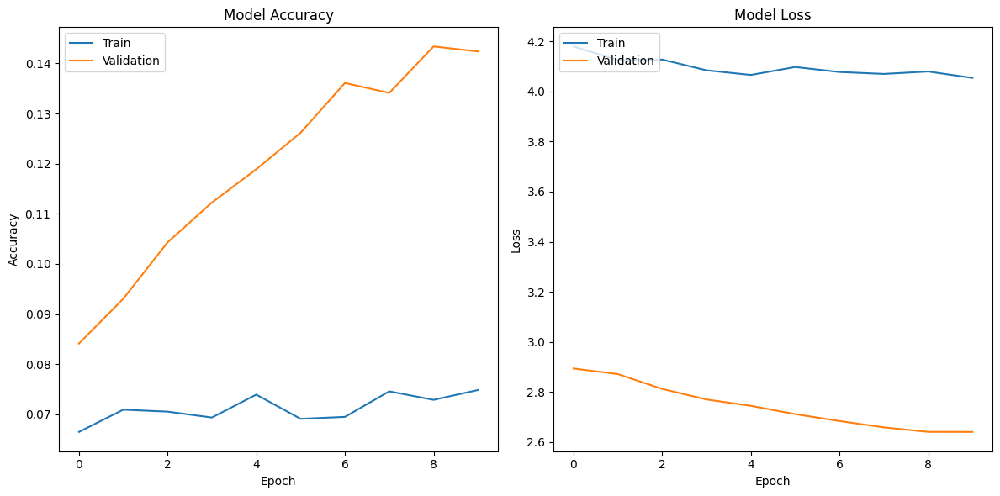

95/95 [==============================] - 41s 437ms/step - loss: 2.6520 - accuracy: 0.1496
Adagrad Model - Test accuracy: 14.96%
95/95 [==============================] - 37s 390ms/step - loss: 2.6405 - accuracy: 0.1424
Adagrad Model - Validation accuracy: 14.24%
95/95 [==============================] - 37s 390ms/step
Classification Report:
              precision    recall  f1-score   support

Amur_Leopard       0.09      0.01      0.02       193
  Arctic_Fox       0.10      0.16      0.13       134
  Chimpanzee       0.24      0.13      0.17       166
     Jaguars       0.43      0.14      0.21       212
        Lion       0.16      0.14      0.15       271
   Orangutan       0.03      0.01      0.01       176
       Panda       0.21      0.07      0.11       283
    Panthers       0.12      0.05      0.07       205
       Rhino       0.14      0.06      0.08       249
      belgua       0.46      0.24      0.32       231
    cheetahs       0.18      0.19      0.19       207
       hey

In [18]:
plot_learning_curves(history_adagrad) 
print_accuracy(model_adagrad, "Adagrad Model", test, val)
evaluate_model(model_adagrad, val, class_labels)

In [15]:
model_rmsprop, history_rmsprop = create_and_train_model(optimizer='rmsprop', learning_rate=1e-4, name='rmsprop_model')

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

c:\Users\sudha\py10\lib\site-packages\keras\optimizers\optimizer_v2\rmsprop.py:140: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


Epoch 1/10
240/240 [==============================] - 234s 931ms/step - loss: 3.9297 - accuracy: 0.0789 - val_loss: 5.6642 - val_accuracy: 0.0500 - lr: 1.0000e-04
Epoch 2/10
240/240 [==============================] - 193s 806ms/step - loss: 3.6975 - accuracy: 0.0734 - val_loss: 2.8692 - val_accuracy: 0.1083 - lr: 1.0000e-04
Epoch 3/10
240/240 [==============================] - 181s 751ms/step - loss: 3.5545 - accuracy: 0.0717 - val_loss: 2.9284 - val_accuracy: 0.0672 - lr: 9.0000e-05
Epoch 4/10
240/240 [==============================] - 199s 832ms/step - loss: 3.4752 - accuracy: 0.0738 - val_loss: 2.6823 - val_accuracy: 0.0603 - lr: 9.0000e-05
Epoch 5/10
240/240 [==============================] - 194s 810ms/step - loss: 3.4243 - accuracy: 0.0691 - val_loss: 2.6299 - val_accuracy: 0.1212 - lr: 8.1000e-05
Epoch 6/10
240/240 [==============================] - 182s 757ms/step - loss: 3.3266 - accuracy: 0.0699 - val_loss: 2.6700 - val_accuracy: 0.0907 - lr: 8.1000e-05
Epoch 7/10
240/240 [==

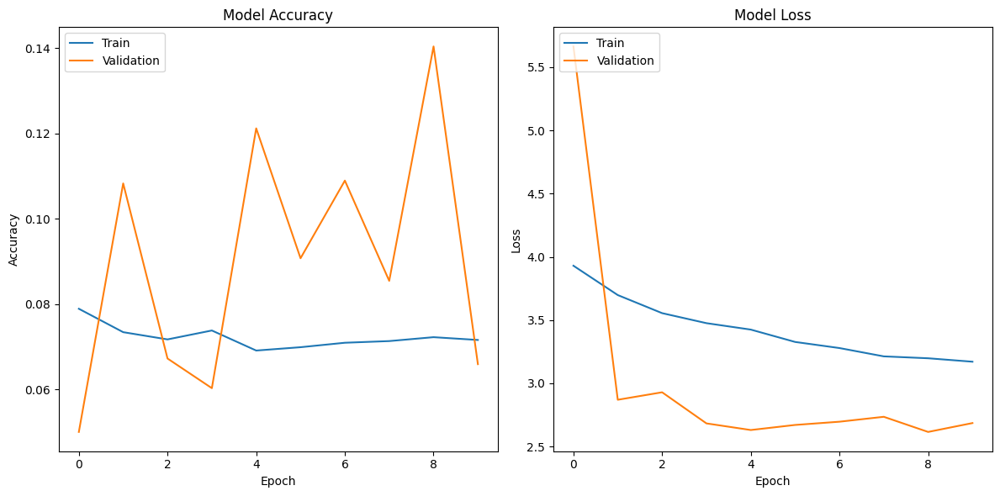

95/95 [==============================] - 37s 394ms/step - loss: 2.6840 - accuracy: 0.0713
rmsprop Model - Test accuracy: 7.13%
95/95 [==============================] - 32s 335ms/step - loss: 2.6850 - accuracy: 0.0659
rmsprop Model - Validation accuracy: 6.59%
95/95 [==============================] - 32s 332ms/step
Classification Report:
              precision    recall  f1-score   support

Amur_Leopard       0.02      0.01      0.01       193
  Arctic_Fox       0.04      0.03      0.03       134
  Chimpanzee       0.11      0.34      0.16       166
     Jaguars       0.08      0.04      0.06       212
        Lion       0.00      0.00      0.00       271
   Orangutan       0.00      0.00      0.00       176
       Panda       0.06      0.06      0.06       283
    Panthers       0.00      0.00      0.00       205
       Rhino       0.08      0.15      0.10       249
      belgua       0.00      0.00      0.00       231
    cheetahs       0.01      0.02      0.01       207
       heyna

In [16]:
plot_learning_curves(history_rmsprop) 
print_accuracy(model_rmsprop, "rmsprop Model", test, val)
evaluate_model(model_rmsprop, val, class_labels)

In [20]:
model_sgd, history_sgd = create_and_train_model(optimizer='sgd', learning_rate=1e-4, name='sgd_model')

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

c:\Users\sudha\py10\lib\site-packages\keras\optimizers\optimizer_v2\gradient_descent.py:111: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


Epoch 1/10
240/240 [==============================] - 191s 785ms/step - loss: 4.1465 - accuracy: 0.0733 - val_loss: 2.9025 - val_accuracy: 0.0762 - lr: 1.0000e-04
Epoch 2/10
240/240 [==============================] - 182s 759ms/step - loss: 4.1241 - accuracy: 0.0716 - val_loss: 2.8629 - val_accuracy: 0.0841 - lr: 1.0000e-04
Epoch 3/10
240/240 [==============================] - 184s 769ms/step - loss: 4.1349 - accuracy: 0.0750 - val_loss: 2.8260 - val_accuracy: 0.0887 - lr: 9.0000e-05
Epoch 4/10
240/240 [==============================] - 173s 721ms/step - loss: 4.0618 - accuracy: 0.0695 - val_loss: 2.8200 - val_accuracy: 0.0987 - lr: 9.0000e-05
Epoch 5/10
240/240 [==============================] - 175s 731ms/step - loss: 4.0764 - accuracy: 0.0710 - val_loss: 2.7996 - val_accuracy: 0.0980 - lr: 8.1000e-05
Epoch 6/10
240/240 [==============================] - 177s 736ms/step - loss: 4.0642 - accuracy: 0.0687 - val_loss: 2.7744 - val_accuracy: 0.1040 - lr: 8.1000e-05
Epoch 7/10
240/240 [==

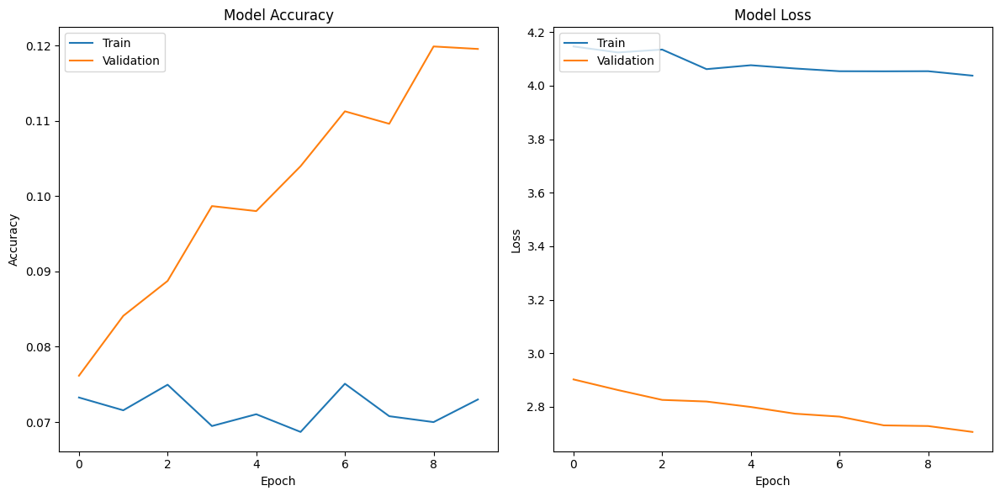

95/95 [==============================] - 33s 342ms/step - loss: 2.6920 - accuracy: 0.1238
sgd Model - Test accuracy: 12.38%
95/95 [==============================] - 33s 347ms/step - loss: 2.7063 - accuracy: 0.1195
sgd Model - Validation accuracy: 11.95%
95/95 [==============================] - 33s 346ms/step
Classification Report:
              precision    recall  f1-score   support

Amur_Leopard       0.10      0.16      0.12       193
  Arctic_Fox       0.10      0.29      0.15       134
  Chimpanzee       0.16      0.19      0.18       166
     Jaguars       0.14      0.20      0.16       212
        Lion       0.13      0.03      0.05       271
   Orangutan       0.10      0.06      0.07       176
       Panda       0.20      0.10      0.13       283
    Panthers       0.08      0.05      0.07       205
       Rhino       0.12      0.10      0.11       249
      belgua       0.21      0.10      0.13       231
    cheetahs       0.10      0.24      0.14       207
       heyna      

In [21]:
plot_learning_curves(history_sgd) 
print_accuracy(model_sgd, "sgd Model", test, val)
evaluate_model(model_sgd, val, class_labels)

Trying out with simple model frozen :

In [16]:

def create_and_train_simple_model(optimizer, learning_rate=1e-4, name="model"):
    baseModel = VGG16(weights="imagenet", include_top=False, input_tensor=Input(shape=(224, 224, 3)))

    # Freeze the convolutional base
    for layer in baseModel.layers:
        layer.trainable = False
        
    headModel = baseModel.output
    headModel = Flatten(name="flatten")(headModel)
    headModel = Dense(256, activation="relu")(headModel)
    headModel = Dropout(0.5)(headModel)
    headModel = Dense(256, activation="relu")(headModel)
    headModel = Dropout(0.5)(headModel)
    headModel = Dense(14, activation="softmax")(headModel)
    
    # unfreeze_layers = 5

    # # Unfreeze layers starting from the specified index
    # for layer in baseModel.layers[-unfreeze_layers:]:
    #     layer.trainable = True

    model = Model(inputs=baseModel.input, outputs=headModel)

    
    # Compile the model with the specified optimizer and learning rate
    if optimizer == 'sgd':
        opt = SGD(lr=learning_rate)
    elif optimizer == 'adam':
        opt = Adam(lr=learning_rate)
    elif optimizer == 'rmsprop':
        opt = RMSprop(lr=learning_rate)
    elif optimizer == 'adagrad':
        opt = Adagrad(lr=learning_rate)
    else:
        raise ValueError("Invalid optimizer specified.")

    model.compile(loss="categorical_crossentropy", optimizer=opt, metrics=["accuracy"])

    # Display the model summary
    model.summary()

    # Learning rate scheduler function
    def lr_scheduler(epoch, lr):
        if epoch % 2 == 0 and epoch > 0:
            lr = lr * 0.9
        return lr

    # Train the model
    history = model.fit(
        x=train,
        steps_per_epoch=len(train),
        validation_data=val,
        validation_steps=len(val),
        epochs=10,  # You can adjust the number of epochs
        callbacks=[
            EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
            ModelCheckpoint(f'best_model_{name}.h5', monitor='val_loss', save_best_only=True),
            LearningRateScheduler(lr_scheduler)
        ],
        class_weight=class_weight_dict
    )
    
    # Save the entire model
    model.save(f'{name}_model.h5')

    return model, history

# Example usage:
# model, history = create_and_train_model(optimizer='adam', learning_rate=1e-4, name='adam_model')
# plot_learning_curves2(history)  # Assuming you have the plot_learning_curves2 function defined
# print_accuracy(model, "Adam Model", test, val)


Trying out simple unforzen model

In [22]:

def create_and_train_simple_model_unf(optimizer, learning_rate=1e-4, name="model"):
    baseModel = VGG16(weights="imagenet", include_top=False, input_tensor=Input(shape=(224, 224, 3)))

    # Freeze the convolutional base
    for layer in baseModel.layers:
        layer.trainable = False
        
    headModel = baseModel.output
    headModel = Flatten(name="flatten")(headModel)
    headModel = Dense(256, activation="relu")(headModel)
    headModel = Dropout(0.5)(headModel)
    headModel = Dense(256, activation="relu")(headModel)
    headModel = Dropout(0.5)(headModel)
    headModel = Dense(14, activation="softmax")(headModel)
    
    unfreeze_layers = 5

    # Unfreeze layers starting from the specified index
    for layer in baseModel.layers[-unfreeze_layers:]:
        layer.trainable = True

    model = Model(inputs=baseModel.input, outputs=headModel)

    
    # Compile the model with the specified optimizer and learning rate
    if optimizer == 'sgd':
        opt = SGD(lr=learning_rate)
    elif optimizer == 'adam':
        opt = Adam(lr=learning_rate)
    elif optimizer == 'rmsprop':
        opt = RMSprop(lr=learning_rate)
    elif optimizer == 'adagrad':
        opt = Adagrad(lr=learning_rate)
    else:
        raise ValueError("Invalid optimizer specified.")

    model.compile(loss="categorical_crossentropy", optimizer=opt, metrics=["accuracy"])

    # Display the model summary
    model.summary()

    # Learning rate scheduler function
    def lr_scheduler(epoch, lr):
        if epoch % 2 == 0 and epoch > 0:
            lr = lr * 0.9
        return lr

    # Train the model
    history = model.fit(
        x=train,
        steps_per_epoch=len(train),
        validation_data=val,
        validation_steps=len(val),
        epochs=10,  # You can adjust the number of epochs
        callbacks=[
            EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
            ModelCheckpoint(f'best_model_{name}.h5', monitor='val_loss', save_best_only=True),
            LearningRateScheduler(lr_scheduler)
        ],
        class_weight=class_weight_dict
    )
    
    # Save the entire model
    model.save(f'{name}_model.h5')

    return model, history

# Example usage:
# model, history = create_and_train_model(optimizer='adam', learning_rate=1e-4, name='adam_model')
# plot_learning_curves2(history)  # Assuming you have the plot_learning_curves2 function defined
# print_accuracy(model, "Adam Model", test, val)


In [18]:
model_simple_rmsprop, history_simple_rmsprop = create_and_train_simple_model(optimizer='rmsprop', learning_rate=1e-4, name='rmsprop_model_simple_freez')

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

c:\Users\sudha\py10\lib\site-packages\keras\optimizers\optimizer_v2\rmsprop.py:140: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


Epoch 1/10
240/240 [==============================] - 165s 686ms/step - loss: 5.9339 - accuracy: 0.1580 - val_loss: 2.1241 - val_accuracy: 0.3099 - lr: 1.0000e-04
Epoch 2/10
240/240 [==============================] - 164s 684ms/step - loss: 2.4694 - accuracy: 0.2403 - val_loss: 1.9937 - val_accuracy: 0.3728 - lr: 1.0000e-04
Epoch 3/10
240/240 [==============================] - 164s 683ms/step - loss: 2.2917 - accuracy: 0.2980 - val_loss: 1.7548 - val_accuracy: 0.4467 - lr: 9.0000e-05
Epoch 4/10
240/240 [==============================] - 170s 708ms/step - loss: 2.1947 - accuracy: 0.3460 - val_loss: 1.6679 - val_accuracy: 0.4543 - lr: 9.0000e-05
Epoch 5/10
240/240 [==============================] - 165s 689ms/step - loss: 2.0990 - accuracy: 0.3842 - val_loss: 1.5243 - val_accuracy: 0.5066 - lr: 8.1000e-05
Epoch 6/10
240/240 [==============================] - 166s 690ms/step - loss: 2.0200 - accuracy: 0.4275 - val_loss: 1.4426 - val_accuracy: 0.5778 - lr: 8.1000e-05
Epoch 7/10
240/240 [==

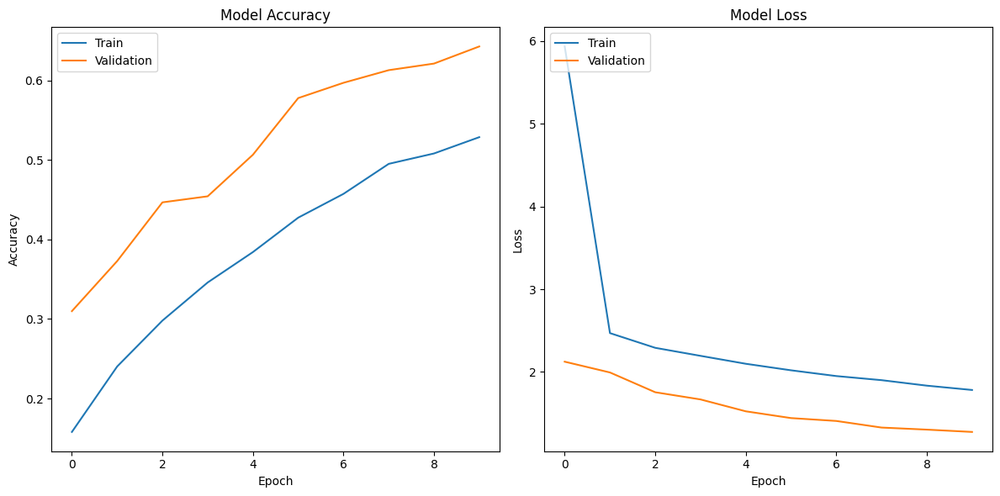

95/95 [==============================] - 36s 381ms/step - loss: 1.2673 - accuracy: 0.6504
 Simple Model with rmsprop - Test accuracy: 65.04%
95/95 [==============================] - 33s 344ms/step - loss: 1.2750 - accuracy: 0.6427
 Simple Model with rmsprop - Validation accuracy: 64.27%
95/95 [==============================] - 32s 343ms/step
Classification Report:
              precision    recall  f1-score   support

Amur_Leopard       0.00      0.00      0.00       193
  Arctic_Fox       0.57      0.87      0.69       134
  Chimpanzee       1.00      0.01      0.02       166
     Jaguars       0.21      0.71      0.32       212
        Lion       0.66      0.21      0.32       271
   Orangutan       1.00      0.01      0.02       176
       Panda       0.83      0.96      0.89       283
    Panthers       0.85      0.76      0.80       205
       Rhino       0.82      0.93      0.87       249
      belgua       0.97      1.00      0.99       231
    cheetahs       0.76      0.63     

c:\Users\sudha\py10\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\sudha\py10\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\sudha\py10\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [19]:
plot_learning_curves(history_simple_rmsprop) 
print_accuracy(model_simple_rmsprop, " Simple Model with rmsprop", test, val)
evaluate_model(model_simple_rmsprop, val, class_labels)

In [23]:
model_simple_rmsprop_unf, history_simple_rmsprop_unf = create_and_train_simple_model_unf(optimizer='rmsprop', learning_rate=1e-4, name='rmsprop_model_simple_unfreez')

Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

c:\Users\sudha\py10\lib\site-packages\keras\optimizers\optimizer_v2\rmsprop.py:140: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


Epoch 1/10
240/240 [==============================] - 181s 747ms/step - loss: 2.7548 - accuracy: 0.1252 - val_loss: 2.2400 - val_accuracy: 0.2722 - lr: 1.0000e-04
Epoch 2/10
240/240 [==============================] - 167s 697ms/step - loss: 2.2760 - accuracy: 0.2659 - val_loss: 2.1227 - val_accuracy: 0.3116 - lr: 1.0000e-04
Epoch 3/10
240/240 [==============================] - 167s 695ms/step - loss: 2.1825 - accuracy: 0.3049 - val_loss: 2.0284 - val_accuracy: 0.3060 - lr: 9.0000e-05
Epoch 4/10
240/240 [==============================] - 169s 703ms/step - loss: 2.1181 - accuracy: 0.3258 - val_loss: 1.9753 - val_accuracy: 0.3149 - lr: 9.0000e-05
Epoch 5/10
240/240 [==============================] - 168s 699ms/step - loss: 2.0682 - accuracy: 0.3507 - val_loss: 2.2270 - val_accuracy: 0.2921 - lr: 8.1000e-05
Epoch 6/10
240/240 [==============================] - 172s 719ms/step - loss: 2.0435 - accuracy: 0.3573 - val_loss: 2.0033 - val_accuracy: 0.3132 - lr: 8.1000e-05
Epoch 7/10
240/240 [==

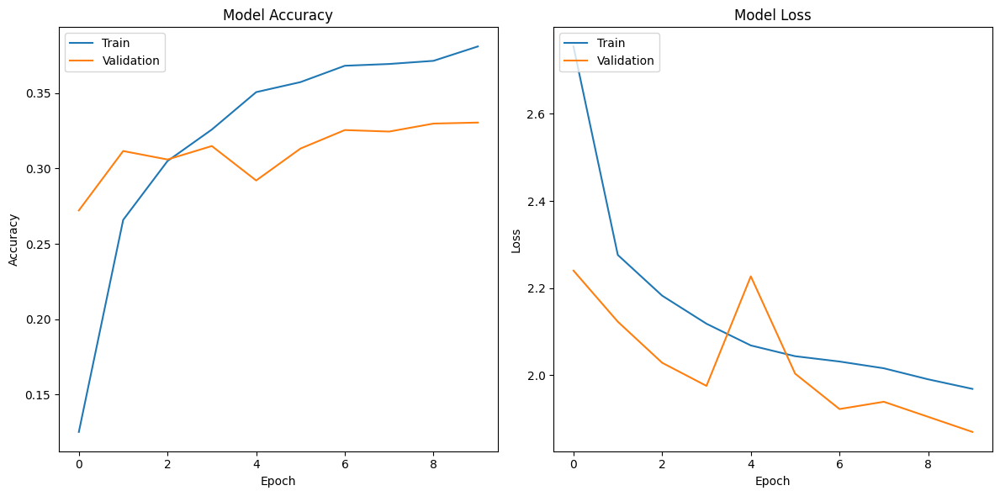

95/95 [==============================] - 33s 344ms/step - loss: 1.8820 - accuracy: 0.3331
 Simple Model with rmsprop - Test accuracy: 33.31%
95/95 [==============================] - 32s 335ms/step - loss: 1.8695 - accuracy: 0.3305
 Simple Model with rmsprop - Validation accuracy: 33.05%
95/95 [==============================] - 31s 333ms/step
Classification Report:
              precision    recall  f1-score   support

Amur_Leopard       0.00      0.00      0.00       193
  Arctic_Fox       0.00      0.00      0.00       134
  Chimpanzee       0.00      0.00      0.00       166
     Jaguars       0.00      0.00      0.00       212
        Lion       0.09      0.00      0.01       271
   Orangutan       0.00      0.00      0.00       176
       Panda       0.00      0.00      0.00       283
    Panthers       0.00      0.00      0.00       205
       Rhino       0.16      0.09      0.12       249
      belgua       1.00      1.00      1.00       231
    cheetahs       0.07      0.53     

c:\Users\sudha\py10\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\sudha\py10\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\sudha\py10\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [24]:
plot_learning_curves(history_simple_rmsprop_unf) 
print_accuracy(model_simple_rmsprop_unf, " Simple Model with rmsprop", test, val)
evaluate_model(model_simple_rmsprop_unf, val, class_labels)

Simple model with all other optimizer Forzen since it showed better accuracy when tested with rmsprop which previously had the wrose perfomance

In [25]:
model_simple_adam, history_simple_adam = create_and_train_simple_model(optimizer='adam', learning_rate=1e-4, name='adam_model_simple_freez')


Model: "model_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_6 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

c:\Users\sudha\py10\lib\site-packages\keras\optimizers\optimizer_v2\adam.py:114: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


Epoch 1/10
240/240 [==============================] - 170s 704ms/step - loss: 6.3440 - accuracy: 0.1239 - val_loss: 2.1685 - val_accuracy: 0.3013 - lr: 1.0000e-04
Epoch 2/10
240/240 [==============================] - 168s 698ms/step - loss: 2.4874 - accuracy: 0.2150 - val_loss: 1.9966 - val_accuracy: 0.3848 - lr: 1.0000e-04
Epoch 3/10
240/240 [==============================] - 178s 744ms/step - loss: 2.3363 - accuracy: 0.2621 - val_loss: 1.8752 - val_accuracy: 0.4245 - lr: 9.0000e-05
Epoch 4/10
240/240 [==============================] - 175s 727ms/step - loss: 2.2118 - accuracy: 0.3052 - val_loss: 1.7353 - val_accuracy: 0.4576 - lr: 9.0000e-05
Epoch 5/10
240/240 [==============================] - 166s 691ms/step - loss: 2.1062 - accuracy: 0.3491 - val_loss: 1.6640 - val_accuracy: 0.4586 - lr: 8.1000e-05
Epoch 6/10
240/240 [==============================] - 162s 677ms/step - loss: 2.0349 - accuracy: 0.3772 - val_loss: 1.5324 - val_accuracy: 0.4927 - lr: 8.1000e-05
Epoch 7/10
240/240 [==

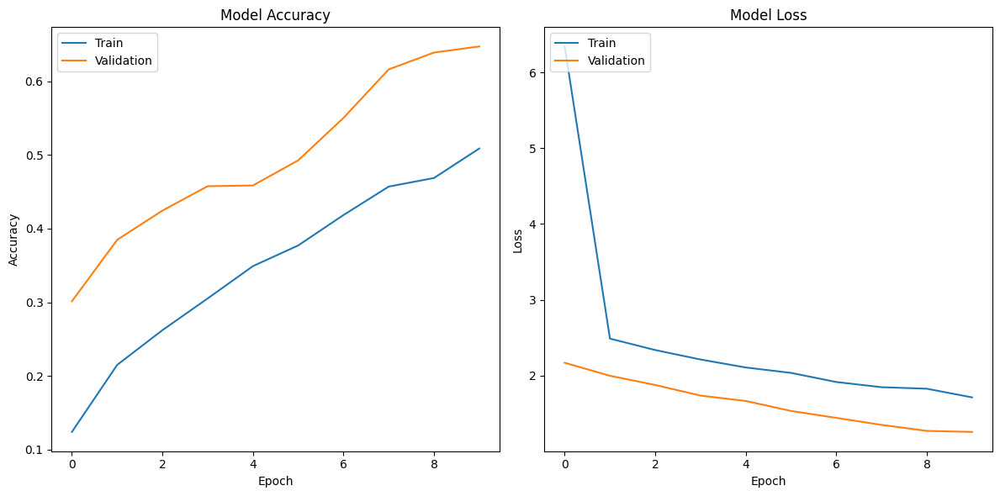

95/95 [==============================] - 32s 340ms/step - loss: 1.2330 - accuracy: 0.6547
 Simple Model with adam - Test accuracy: 65.47%
95/95 [==============================] - 31s 332ms/step - loss: 1.2554 - accuracy: 0.6474
 Simple Model with adam - Validation accuracy: 64.74%
95/95 [==============================] - 31s 330ms/step
Classification Report:
              precision    recall  f1-score   support

Amur_Leopard       0.54      0.16      0.24       193
  Arctic_Fox       0.86      0.84      0.85       134
  Chimpanzee       0.71      0.83      0.77       166
     Jaguars       0.18      0.75      0.29       212
        Lion       0.25      0.00      0.01       271
   Orangutan       0.79      0.37      0.50       176
       Panda       0.93      0.94      0.94       283
    Panthers       0.88      0.69      0.77       205
       Rhino       0.78      0.94      0.85       249
      belgua       0.98      1.00      0.99       231
    cheetahs       0.50      0.01      0.02 

In [26]:
plot_learning_curves(history_simple_adam) 
print_accuracy(model_simple_adam, " Simple Model with adam", test, val)
evaluate_model(model_simple_adam, val, class_labels)

In [27]:
model_simple_adagrad, history_simple_adagrad = create_and_train_simple_model(optimizer='adagrad', learning_rate=1e-4, name='adagrad_model_simple_freez')


Model: "model_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_7 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

c:\Users\sudha\py10\lib\site-packages\keras\optimizers\optimizer_v2\adagrad.py:81: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


Epoch 1/10
240/240 [==============================] - 166s 690ms/step - loss: 16.1729 - accuracy: 0.0917 - val_loss: 4.1225 - val_accuracy: 0.2315 - lr: 1.0000e-04
Epoch 2/10
240/240 [==============================] - 166s 692ms/step - loss: 9.4033 - accuracy: 0.1280 - val_loss: 3.2184 - val_accuracy: 0.2556 - lr: 1.0000e-04
Epoch 3/10
240/240 [==============================] - 165s 685ms/step - loss: 7.1988 - accuracy: 0.1280 - val_loss: 2.8473 - val_accuracy: 0.2629 - lr: 9.0000e-05
Epoch 4/10
240/240 [==============================] - 166s 689ms/step - loss: 5.9474 - accuracy: 0.1327 - val_loss: 2.6568 - val_accuracy: 0.2679 - lr: 9.0000e-05
Epoch 5/10
240/240 [==============================] - 165s 689ms/step - loss: 5.1373 - accuracy: 0.1277 - val_loss: 2.5609 - val_accuracy: 0.2583 - lr: 8.1000e-05
Epoch 6/10
240/240 [==============================] - 166s 692ms/step - loss: 4.6934 - accuracy: 0.1360 - val_loss: 2.4912 - val_accuracy: 0.2632 - lr: 8.1000e-05
Epoch 7/10
240/240 [=

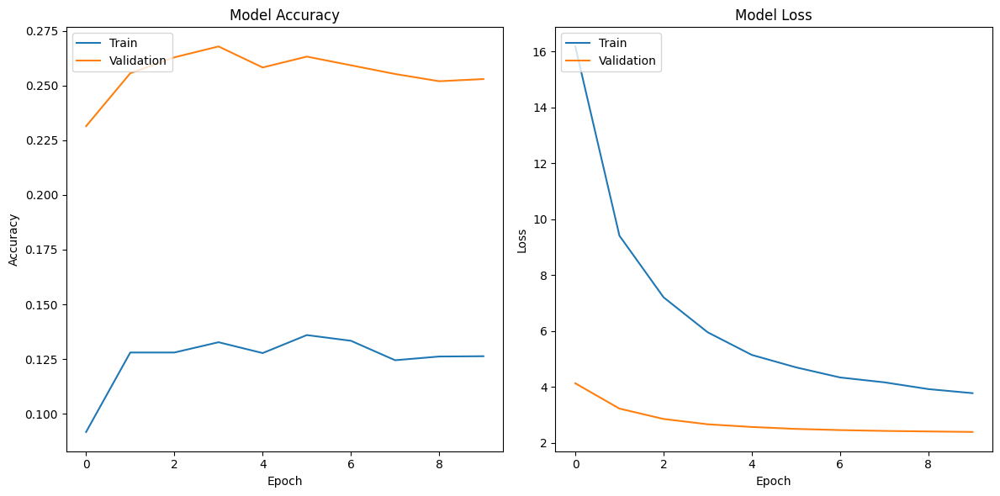

95/95 [==============================] - 34s 356ms/step - loss: 2.3514 - accuracy: 0.2493
 Simple Model with adagrad - Test accuracy: 24.93%
95/95 [==============================] - 32s 343ms/step - loss: 2.3831 - accuracy: 0.2530
 Simple Model with adagrad - Validation accuracy: 25.30%
95/95 [==============================] - 32s 338ms/step
Classification Report:
              precision    recall  f1-score   support

Amur_Leopard       0.25      0.30      0.27       193
  Arctic_Fox       0.13      0.30      0.18       134
  Chimpanzee       0.33      0.36      0.34       166
     Jaguars       0.37      0.13      0.19       212
        Lion       0.17      0.22      0.19       271
   Orangutan       0.17      0.11      0.13       176
       Panda       0.43      0.52      0.47       283
    Panthers       0.15      0.14      0.15       205
       Rhino       0.24      0.52      0.33       249
      belgua       0.80      0.26      0.39       231
    cheetahs       0.12      0.14     

In [28]:
plot_learning_curves(history_simple_adagrad) 
print_accuracy(model_simple_adagrad, " Simple Model with adagrad", test, val)
evaluate_model(model_simple_adagrad, val, class_labels)

In [30]:
model_simple_sgd, history_simple_sgd = create_and_train_simple_model(optimizer='sgd', learning_rate=1e-4, name='sgd_model_simple_freez')


Model: "model_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_9 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

c:\Users\sudha\py10\lib\site-packages\keras\optimizers\optimizer_v2\gradient_descent.py:111: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


Epoch 1/10
240/240 [==============================] - 173s 713ms/step - loss: 10.9317 - accuracy: 0.1322 - val_loss: 2.3654 - val_accuracy: 0.3248 - lr: 1.0000e-04
Epoch 2/10
240/240 [==============================] - 165s 689ms/step - loss: 3.8302 - accuracy: 0.1549 - val_loss: 2.1475 - val_accuracy: 0.3311 - lr: 1.0000e-04
Epoch 3/10
240/240 [==============================] - 165s 687ms/step - loss: 3.0842 - accuracy: 0.1730 - val_loss: 2.1162 - val_accuracy: 0.3434 - lr: 9.0000e-05
Epoch 4/10
240/240 [==============================] - 167s 698ms/step - loss: 2.8517 - accuracy: 0.1903 - val_loss: 2.0748 - val_accuracy: 0.3599 - lr: 9.0000e-05
Epoch 5/10
240/240 [==============================] - 166s 692ms/step - loss: 2.7552 - accuracy: 0.1924 - val_loss: 2.0459 - val_accuracy: 0.3712 - lr: 8.1000e-05
Epoch 6/10
240/240 [==============================] - 164s 685ms/step - loss: 2.6498 - accuracy: 0.2065 - val_loss: 2.0192 - val_accuracy: 0.3752 - lr: 8.1000e-05
Epoch 7/10
240/240 [=

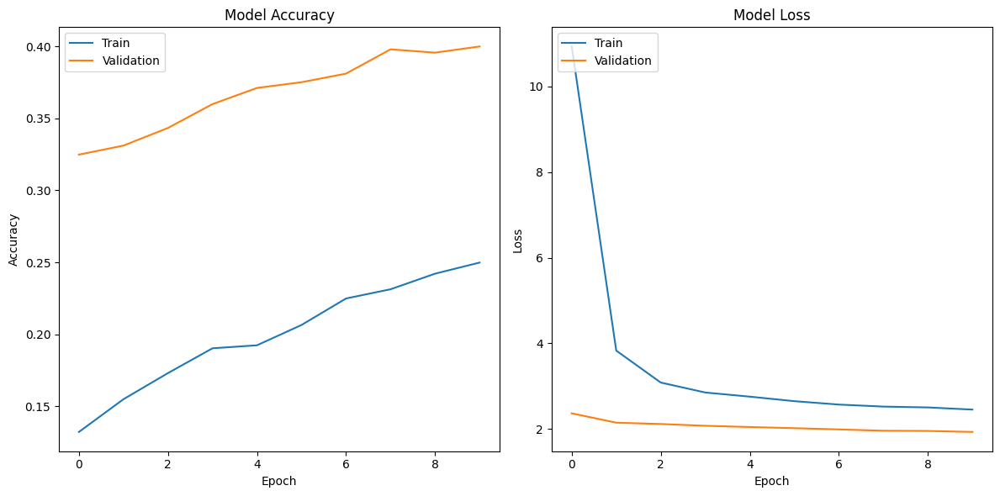

95/95 [==============================] - 32s 340ms/step - loss: 1.9487 - accuracy: 0.3988
 Simple Model with sgd - Test accuracy: 39.88%
95/95 [==============================] - 31s 329ms/step - loss: 1.9311 - accuracy: 0.4000
 Simple Model with sgd - Validation accuracy: 40.00%
95/95 [==============================] - 31s 331ms/step
Classification Report:
              precision    recall  f1-score   support

Amur_Leopard       0.21      0.06      0.09       193
  Arctic_Fox       0.42      0.58      0.49       134
  Chimpanzee       0.40      0.66      0.50       166
     Jaguars       0.28      0.12      0.17       212
        Lion       0.25      0.11      0.15       271
   Orangutan       0.34      0.19      0.25       176
       Panda       0.60      0.79      0.68       283
    Panthers       0.25      0.06      0.10       205
       Rhino       0.31      0.08      0.13       249
      belgua       0.81      0.98      0.89       231
    cheetahs       0.16      0.64      0.25   

In [31]:
plot_learning_curves(history_simple_sgd) 
print_accuracy(model_simple_sgd, " Simple Model with sgd", test, val)
evaluate_model(model_simple_sgd, val, class_labels)

Without using optimizer just a simple model

Observation seeing that it has a hard time classifiing Amur_leopard, after lookiing it it for some time this might be due to the imgaes of this speacies being in small size and leopard looking similar to cheethas in my opinion.

Simple model with Adam optimize is working the best so far, i could have tried the unfrozen model simple but since it perfomend bad with rmsprop optimizer which was alreading doing the worse in before perfomance i went with simple fozen model to test all optimizer and found Adam optimizer with simple model to get the best accuracy go around 65% in all classes of animal for 10 epoch later I will try to use it for 100 epoch for normal dataset and enhanced dataset to see the difference.

Trying the same model on enhanced dataset:

In [19]:
model_simple_adam, history_simple_adam = create_and_train_simple_model(optimizer='adam', learning_rate=1e-4, name='adam_model_simple_freez_enhance')


Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

c:\Users\sudha\py10\lib\site-packages\keras\optimizers\optimizer_v2\adam.py:114: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


Epoch 1/10
240/240 [==============================] - 392s 2s/step - loss: 6.2183 - accuracy: 0.1371 - val_loss: 2.3273 - val_accuracy: 0.2732 - lr: 1.0000e-04
Epoch 2/10
240/240 [==============================] - 220s 917ms/step - loss: 2.5036 - accuracy: 0.2020 - val_loss: 2.1043 - val_accuracy: 0.3371 - lr: 1.0000e-04
Epoch 3/10
240/240 [==============================] - 196s 819ms/step - loss: 2.3811 - accuracy: 0.2500 - val_loss: 2.0380 - val_accuracy: 0.3560 - lr: 9.0000e-05
Epoch 4/10
240/240 [==============================] - 184s 765ms/step - loss: 2.2860 - accuracy: 0.2818 - val_loss: 1.8774 - val_accuracy: 0.4268 - lr: 9.0000e-05
Epoch 5/10
240/240 [==============================] - 223s 925ms/step - loss: 2.2161 - accuracy: 0.3094 - val_loss: 1.8332 - val_accuracy: 0.4467 - lr: 8.1000e-05
Epoch 6/10
240/240 [==============================] - 188s 780ms/step - loss: 2.1523 - accuracy: 0.3345 - val_loss: 1.7531 - val_accuracy: 0.4725 - lr: 8.1000e-05
Epoch 7/10
240/240 [=====

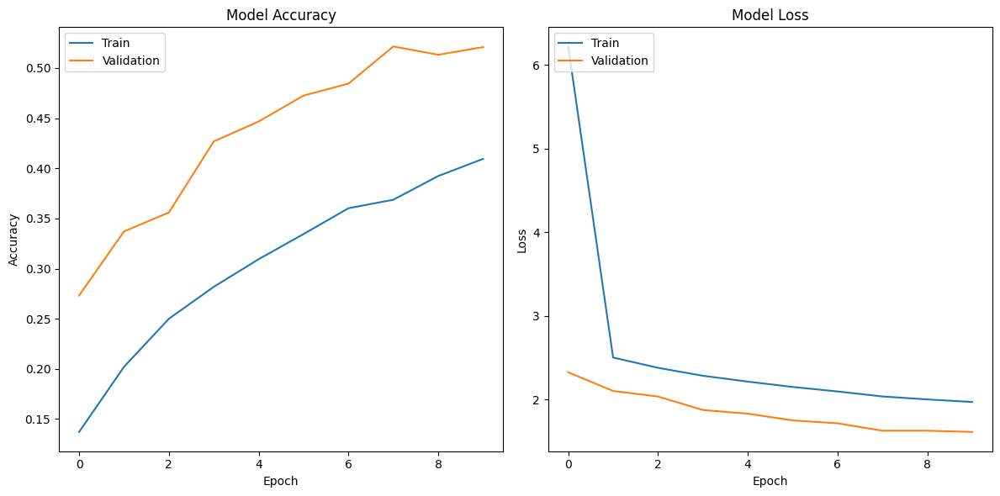

95/95 [==============================] - 66s 694ms/step - loss: 1.5974 - accuracy: 0.5188
 Simple Model with Enhanced image and adam optimizer - Test accuracy: 51.88%
95/95 [==============================] - 32s 341ms/step - loss: 1.6152 - accuracy: 0.5209
 Simple Model with Enhanced image and adam optimizer - Validation accuracy: 52.09%
95/95 [==============================] - 30s 318ms/step
Classification Report:
              precision    recall  f1-score   support

Amur_Leopard       0.00      0.00      0.00       193
  Arctic_Fox       0.50      0.01      0.01       134
  Chimpanzee       0.89      0.70      0.78       166
     Jaguars       0.25      0.00      0.01       212
        Lion       0.33      0.01      0.01       271
   Orangutan       0.60      0.02      0.03       176
       Panda       0.18      0.94      0.30       283
    Panthers       0.83      0.83      0.83       205
       Rhino       0.81      0.92      0.86       249
      belgua       0.95      1.00      0

In [20]:
plot_learning_curves(history_simple_adam) 
print_accuracy(model_simple_adam, " Simple Model with Enhanced image and adam optimizer", test, val)
evaluate_model(model_simple_adam, val, class_labels)